In [261]:
from data_loader import DataLoader
import matplotlib.pyplot as plt

In [262]:
args = {"dataset":"C:/Users/laila/Downloads/BBDD/BBDD"}
DataLoader1 = DataLoader(args)


In [263]:
images = DataLoader1.load_images_from_folder()

287


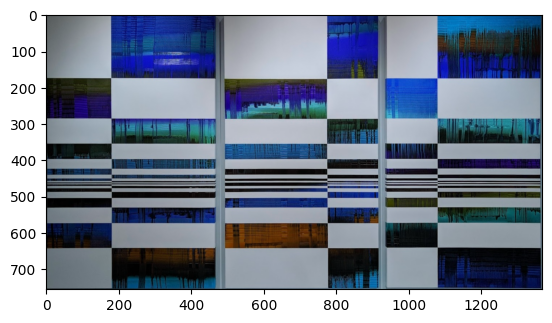

In [264]:
print(len(images))

#Displaying image using plt.imshow() method
plt.imshow(images[0])

In [265]:
# dict histograms
from feature_extractor import FeatureExtractor
FeatureExtractor1 = FeatureExtractor()


images_histograms = []

for img in images:
    dict_img={}
    dict_img['Gray'] = FeatureExtractor1.compute_histogram(img, color_space='Gray', normalize=True,equalize=False)
    dict_img['RGB'] = FeatureExtractor1.compute_histogram(img, color_space='RGB', normalize=True)
    dict_img['HSV'] = FeatureExtractor1.compute_histogram(img, color_space='HSV', normalize=True)
    dict_img['LAB'] = FeatureExtractor1.compute_histogram(img, color_space='LAB', normalize=True)
    dict_img['YCrCb'] = FeatureExtractor1.compute_histogram(img, color_space='YCrCb', normalize=True)
    images_histograms.append(dict_img)


In [266]:
images_histograms

[{'Gray': array([6.34800317e-03, 3.62276137e-02, 6.50010407e-02, 7.01925755e-02,
         8.18201080e-02, 8.93874317e-02, 9.26934183e-02, 9.43149850e-02,
         9.60119814e-02, 9.61376801e-02, 9.66027826e-02, 9.10844207e-02,
         8.51763785e-02, 8.40450525e-02, 7.97962844e-02, 7.59623423e-02,
         7.08336607e-02, 6.93252236e-02, 6.80053458e-02, 6.60820827e-02,
         6.70122877e-02, 6.42719641e-02, 6.66226074e-02, 6.55792728e-02,
         6.51393160e-02, 6.65471852e-02, 6.75528124e-02, 6.73139766e-02,
         6.87972754e-02, 6.94132149e-02, 6.87972754e-02, 6.82693198e-02,
         6.73768297e-02, 6.90612495e-02, 6.87344223e-02, 6.85207248e-02,
         6.89481124e-02, 6.75653815e-02, 6.85584396e-02, 6.78922087e-02,
         6.76910877e-02, 6.57678321e-02, 6.57804012e-02, 6.64969087e-02,
         6.42342493e-02, 6.59312457e-02, 6.43222407e-02, 6.26755357e-02,
         6.19967356e-02, 6.30903542e-02, 6.23989888e-02, 6.37691468e-02,
         6.44353777e-02, 6.18458949e-02, 6.

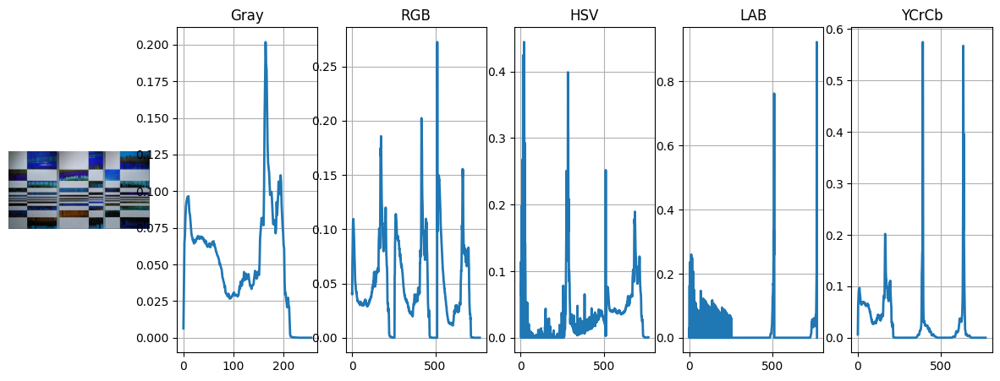

In [267]:
#plotting first image
FeatureExtractor1.plot_histogram(images_histograms[0],images[0])

In [268]:
import pickle

# Save the images_histograms to a pickle file
with open('images_histograms.pkl', 'wb') as file:
    pickle.dump(images_histograms, file, protocol=pickle.HIGHEST_PROTOCOL)

print("Array of images with corresponding dictionaries has been saved to images_histograms.pkl")

Array of images with corresponding dictionaries has been saved to array_of_dicts.pkl


In [269]:
with open('images_histograms.pkl', 'rb') as file:
    images_histograms = pickle.load(file)

print(f"Loaded array of images of length:{len(images_histograms)}", images_histograms)

Loaded array of images of length:287 [{'Gray': array([6.34800317e-03, 3.62276137e-02, 6.50010407e-02, 7.01925755e-02,
       8.18201080e-02, 8.93874317e-02, 9.26934183e-02, 9.43149850e-02,
       9.60119814e-02, 9.61376801e-02, 9.66027826e-02, 9.10844207e-02,
       8.51763785e-02, 8.40450525e-02, 7.97962844e-02, 7.59623423e-02,
       7.08336607e-02, 6.93252236e-02, 6.80053458e-02, 6.60820827e-02,
       6.70122877e-02, 6.42719641e-02, 6.66226074e-02, 6.55792728e-02,
       6.51393160e-02, 6.65471852e-02, 6.75528124e-02, 6.73139766e-02,
       6.87972754e-02, 6.94132149e-02, 6.87972754e-02, 6.82693198e-02,
       6.73768297e-02, 6.90612495e-02, 6.87344223e-02, 6.85207248e-02,
       6.89481124e-02, 6.75653815e-02, 6.85584396e-02, 6.78922087e-02,
       6.76910877e-02, 6.57678321e-02, 6.57804012e-02, 6.64969087e-02,
       6.42342493e-02, 6.59312457e-02, 6.43222407e-02, 6.26755357e-02,
       6.19967356e-02, 6.30903542e-02, 6.23989888e-02, 6.37691468e-02,
       6.44353777e-02, 6.18458

In [270]:
from similarity_calculator import SimilarityCalculator

SimilarityCalculator1=SimilarityCalculator()

# available methods
OPENCV_METHODS = [
            "Correlation",
            "Chi-Squared",
            "Intersection",
            "Hellinger"
        ]

SCIPY_METHODS = [
            "Euclidean",
            "Manhattan",
            "Chebyshev"
]

similarity_results = SimilarityCalculator1.compute_similarity([images_histograms[2],images_histograms[6]],methodName=OPENCV_METHODS[3])
similarity_results


[(0.49996156137425, 'RGB'),
 (0.5107734331065579, 'Gray'),
 (0.5119092400562231, 'HSV'),
 (0.5345517588303257, 'YCrCb'),
 (0.7227760075980663, 'LAB')]

In [271]:
# Load the validation set
args2 = {"dataset":"C:/Users/laila/Downloads/qsd1_w1/qsd1_w1"}
DataLoader2 = DataLoader(args2)

In [272]:
validation_images = DataLoader2.load_images_from_folder()

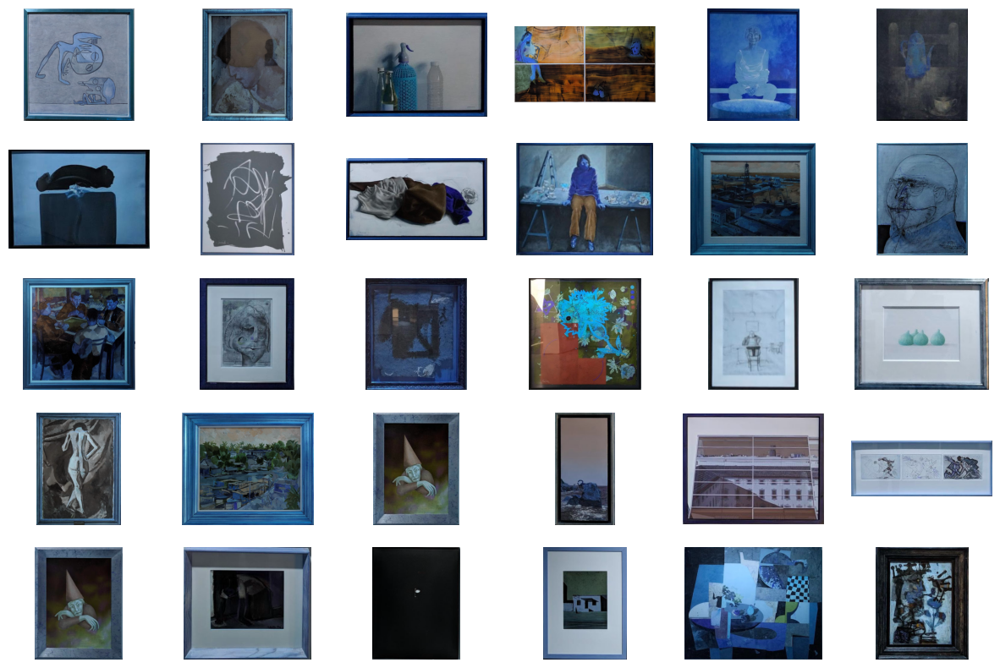

In [273]:
fig, axes = plt.subplots(nrows=5, ncols=6, figsize=(15, 10))

# Plot each image in the grid
for i, ax in enumerate(axes.flat):
    ax.imshow(validation_images[i], cmap='gray')
    ax.axis('off')

plt.show()

In [274]:
validation_images_histograms = []

for validation_image in validation_images:
    dict_img={}
    dict_img['Gray'] = FeatureExtractor1.compute_histogram(validation_image, color_space='Gray', normalize=True,equalize=False)
    dict_img['RGB'] = FeatureExtractor1.compute_histogram(validation_image, color_space='RGB', normalize=True)
    dict_img['HSV'] = FeatureExtractor1.compute_histogram(validation_image, color_space='HSV', normalize=True)
    dict_img['LAB'] = FeatureExtractor1.compute_histogram(validation_image, color_space='LAB', normalize=True)
    dict_img['YCrCb'] = FeatureExtractor1.compute_histogram(validation_image, color_space='YCrCb', normalize=True)
    validation_images_histograms.append(dict_img)

In [275]:
print(len(validation_images_histograms))

30


In [276]:
len(images_histograms)

287

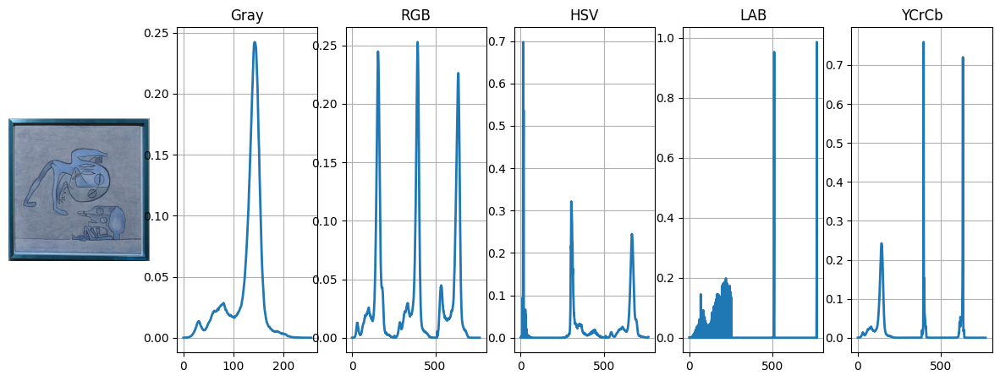

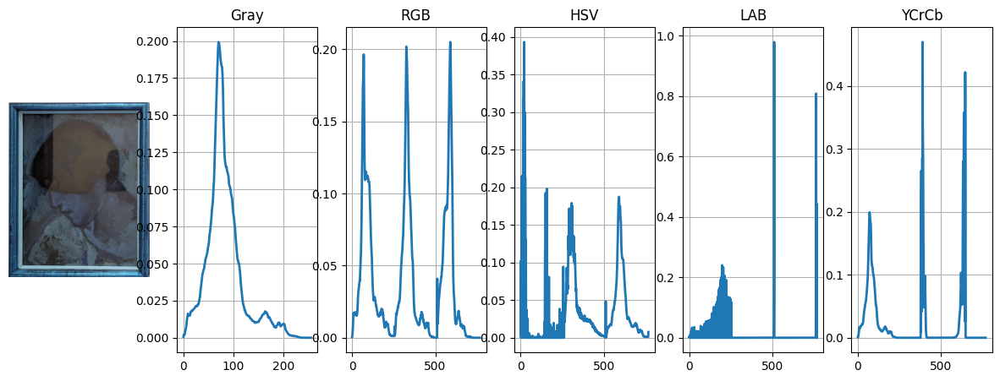

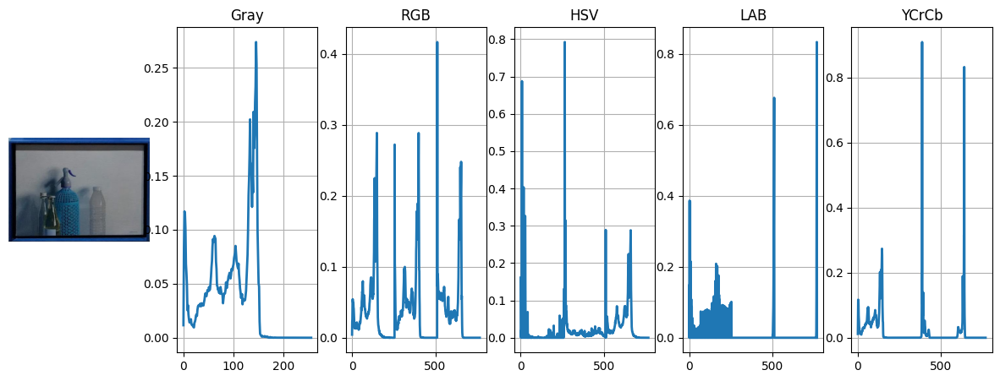

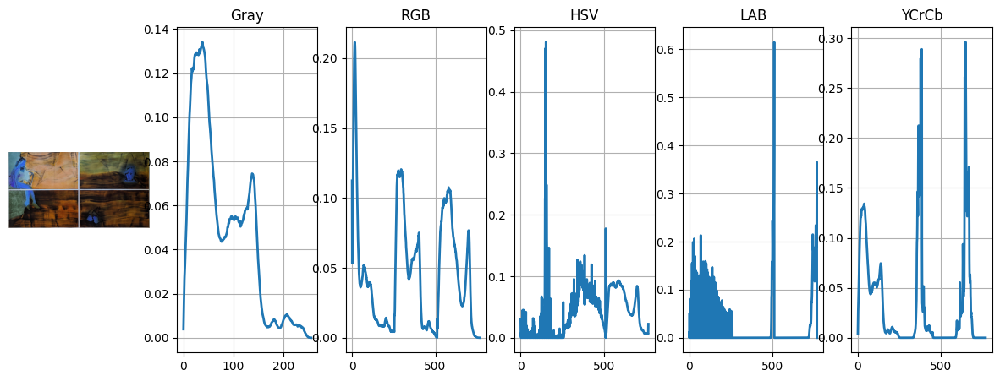

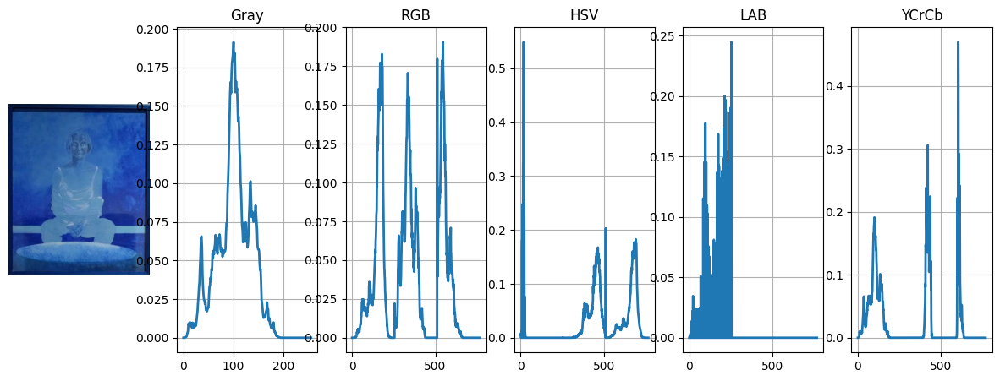

...

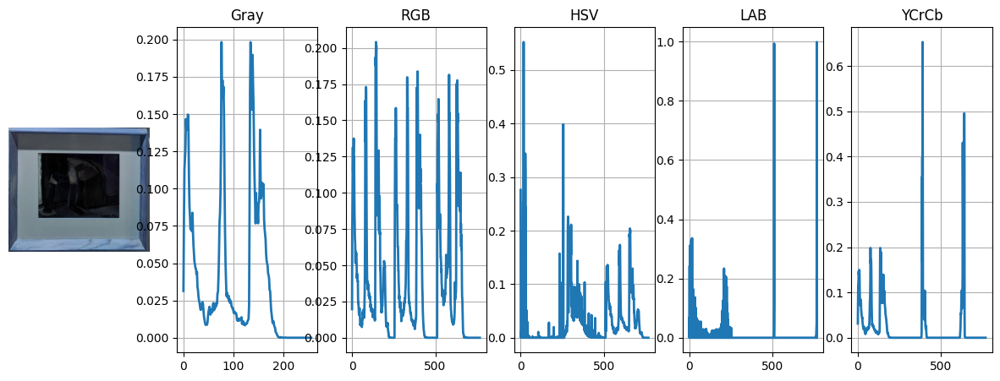

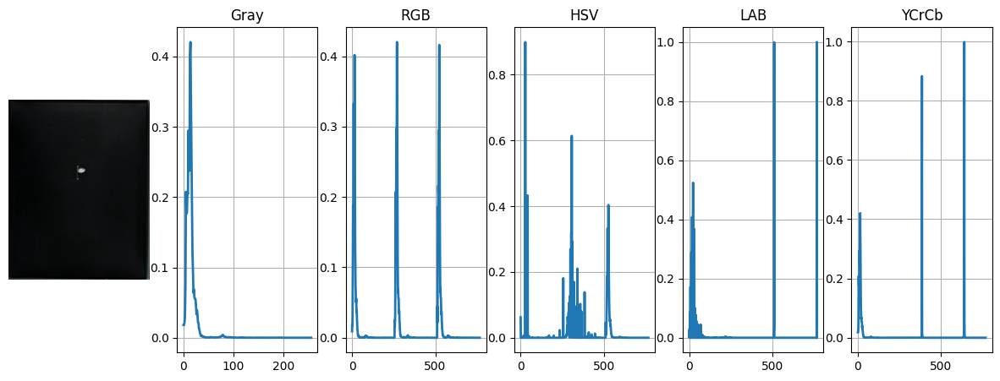

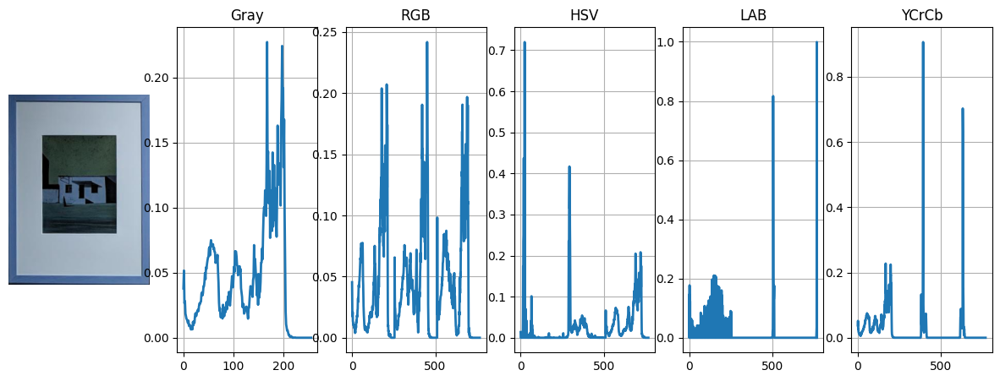

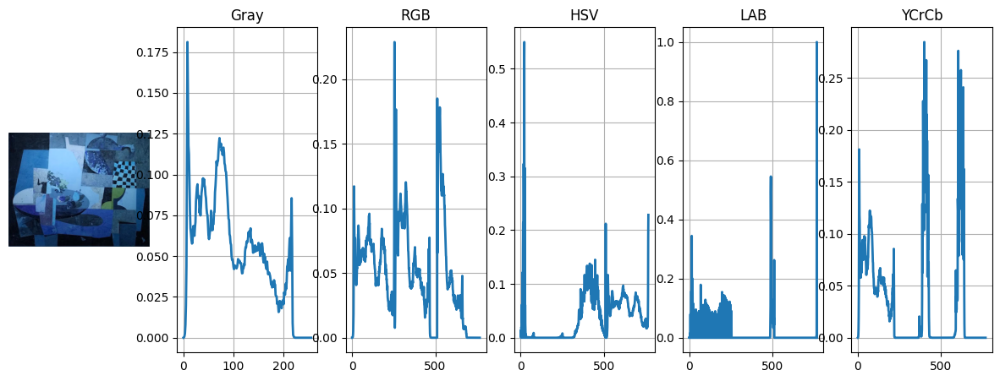

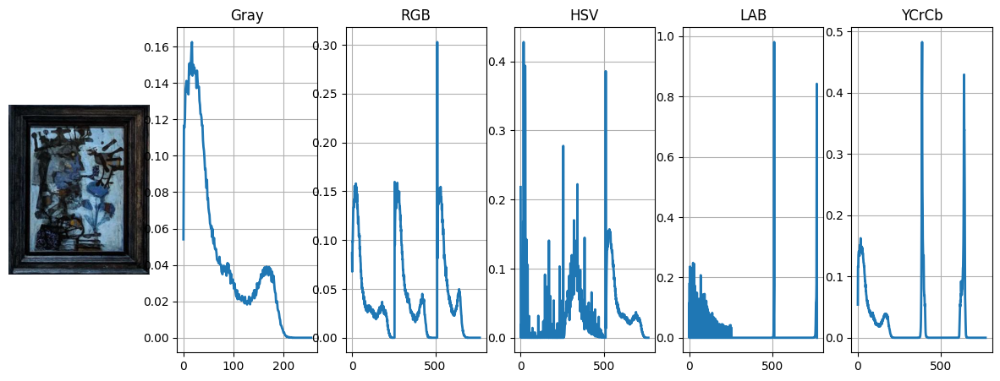

In [277]:
for i in range (30):
    FeatureExtractor1.plot_histogram(validation_images_histograms[i],validation_images[i])

In [356]:
print(OPENCV_METHODS[0])
#SCIPY_METHODS[2]

Correlation


In [357]:
# Get similarity metrics for validation set

validation_results = []
for validation_image_hist in validation_images_histograms:
    results = []
    for image_hist in images_histograms:
        try:
            similarity = SimilarityCalculator1.compute_similarity(
                [validation_image_hist, image_hist], methodName=OPENCV_METHODS[0]
            )
            results.append(similarity)
        except Exception as e:
            print(f"Error computing similarity: {e}")
    
    validation_results.append(results)

In [311]:
print(len(validation_results))
print(len(validation_results[0]))

30
287


In [312]:
print(validation_results[0])
print(validation_results[1])

[[(np.float32(0.2008864), 'Gray'), (np.float32(0.25805926), 'LAB'), (np.float32(0.26700354), 'RGB'), (np.float32(0.39468086), 'HSV'), (np.float32(0.7234131), 'YCrCb')], [(np.float32(0.94126534), 'Gray'), (np.float32(0.9484001), 'YCrCb'), (np.float32(0.9684), 'RGB'), (np.float32(0.96905285), 'HSV'), (np.float32(0.9852118), 'LAB')], [(np.float32(0.15187702), 'Gray'), (np.float32(0.18664205), 'RGB'), (np.float32(0.5136445), 'LAB'), (np.float32(0.59977746), 'HSV'), (np.float32(0.663533), 'YCrCb')], [(np.float32(0.17023845), 'Gray'), (np.float32(0.23701607), 'RGB'), (np.float32(0.5446104), 'HSV'), (np.float32(0.60198116), 'LAB'), (np.float32(0.6417669), 'YCrCb')], [(np.float32(0.17225325), 'Gray'), (np.float32(0.18813975), 'RGB'), (np.float32(0.5434966), 'HSV'), (np.float32(0.60205805), 'YCrCb'), (np.float32(0.6086918), 'LAB')], [(np.float32(0.16030978), 'Gray'), (np.float32(0.17129909), 'RGB'), (np.float32(0.5328276), 'HSV'), (np.float32(0.8849975), 'YCrCb'), (np.float32(0.9852118), 'LAB')

In [365]:
from retrieval_system import RetrievalSystem
RetrievalSystem1=RetrievalSystem()
# Color scales to search
#color_names = ['RGB', 'Gray', 'HSV', 'YCrCb', 'LAB']
color_names = ['RGB']

method = "Correlation"  # or "Intersection", "Euclidean", etc.
K = 1  # Number of top values to return
final=[]
for i in range(len(validation_results)):
    #top_k_indices_dict = {color_name: RetrievalSystem1.search_top_k_values(validation_results[i], color_name, method, K) for color_name in color_names}
    final.append(RetrievalSystem1.search_top_k_values(validation_results[i], color_names[0], method, K))
    #print(i,top_k_indices_dict)
print(final)

[[120], [109], [120], [227], [156], [128], [50], [258], [0], [8], [88], [51], [218], [232], [32], [155], [77], [36], [8], [239], [241], [6], [257], [18], [170], [229], [71], [67], [86], [133]]


In [286]:
file_path = 'C:/Users/laila/Downloads/qsd1_w1/qsd1_w1/gt_corresps.pkl'

with open(file_path, 'rb') as file:
    ground_truth = pickle.load(file)


In [366]:
from evaluator import Evaluator
Evaluator1 = Evaluator()
Evaluator1.evaluate(final,ground_truth)

26.666666666666668

In [285]:
#Method 1 -> HSV , Euclidean
#33.3
#Method 1 -> RGB , Euclidean
#26.7
#Method 1 -> Gray , Euclidean
#20


In [ ]:
#Method 2 -> HSV , Manhattan
#43.3
#Method 2 -> RGB , Manhattan
#33.3
#Method 2 -> Gray , Manhattan
#20
#Method 2 -> YCrCb , Manhattan
#50
#Method 2 -> LAB , Manhattan
#30

In [ ]:
#Method 3 -> RGB, Hellinger
#33.3
#HSV,40
#Gray,23.3
#YCrCb,33.3
#LAB,23.3
